# **Overview**

This notebook focuses on **Tomato Leaf Disease Detection** using the **Ultralytics YOLO11-L** object detection model.
The dataset contains 7 classes of tomato leaf conditions—
Bacterial Spot, Early_Blight, Healthy, Late_blight, Leaf Mold, Target_Spot, and Black Spot organized in YOLO format with separate train, validation, and test splits.

**Key steps included:**
1. Exploratory Data Analysis (EDA)
    * Verified image/label consistency and inspected bounding boxes.
    * Explored class distributions to understand natural imbalance in the dataset.

2. Model Training

    * Trained YOLO11-L with a variety of built-in augmentations (mosaic, mixup, blur, grayscale, CLAHE) to improve generalization.
    * Used a training image size of 640 px, mixed precision (amp=True).
    * No oversampling was applied; the model learned directly from the original dataset.
    
3. Evaluation

    * Achieved a Test mAP50 of 71.5% and a Train mAP50 of 72.6%, showing strong detection ability and limited overfitting.
    * Visual inspection of predictions confirmed that the model captures disease patterns across all classes, even the rarer ones.

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/tomato-leaf-diseases-detection-computer-vision/README.dataset.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/README.roboflow.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/data.yaml
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_0272_JPG.rf.09589608e4153af9abd9d62ebc699e3f.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_0360_JPG.rf.acbc78f9aaeed09a388f2f0fb8ffb92a.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_0230_JPG.rf.6aa737da228dfd6ab26b74bbcd84b98e.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_0366_JPG.rf.4aef33c7c8c8f5a462d6b4bfb2354b9e.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_1046_JPG.rf.19e5ed4a611cbed9d4de428f67e3f17f.txt
/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels/IMG_0374_JPG.rf.d8500567e50eea6cf2959891f12af373.txt
/kaggl

# **Import packages**

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 30.1 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 108.8 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.6 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 75.5 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall:

In [3]:
from ultralytics import YOLO
import cv2
import torch
import os
from google.colab.patches import cv2_imshow
import random
import matplotlib.pyplot as plt
import os
import seaborn as sns
from PIL import Image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# **Load the dataset**

In [4]:
train_images_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/train/images"
train_labels_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/train/labels"
test_images_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images"
test_labels_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/labels"
valid_images_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/images"
valid_labels_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/valid/labels"

# **Visualize the data**

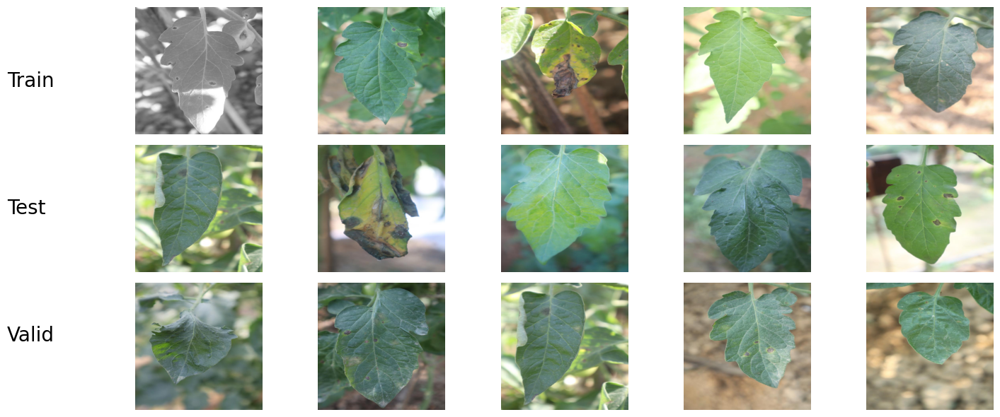

In [5]:
# Pick first 5 images from each folder 
train_files = os.listdir(train_images_dir)[:5] 
test_files = os.listdir(test_images_dir)[:5] 
valid_files = os.listdir(valid_images_dir)[:5]

num_images = 5
plt.figure(figsize=(15, 6))

for i in range(num_images):
    # ---- Train row ----
    img = cv2.imread(os.path.join(train_images_dir, train_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1)
    plt.imshow(img)
    plt.axis("off")

    # ---- Test row ----
    img = cv2.imread(os.path.join(test_images_dir, test_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1 + num_images)
    plt.imshow(img)
    plt.axis("off")

    # ---- Validation row ----
    img = cv2.imread(os.path.join(valid_images_dir, valid_files[i]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3, num_images, i + 1 + 2*num_images)
    plt.imshow(img)
    plt.axis("off")

# 🔹 Add row labels on the left
plt.tight_layout()
plt.subplots_adjust(left=0.1)  # leave space for labels
plt.figtext(0.02, 0.80, "Train", fontsize=20, ha="left", va="center")
plt.figtext(0.02, 0.50, "Test", fontsize=20, ha="left", va="center")
plt.figtext(0.02, 0.20, "Valid", fontsize=20, ha="left", va="center")

plt.show()


# **EDA**

# Count total images

In [6]:
base_dir = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision"
splits = ["train", "test", "valid"]

data_summary = []
all_labels_df = []

In [7]:
for split in splits:
    img_dir = os.path.join(base_dir, split, "images")
    lbl_dir = os.path.join(base_dir, split, "labels")

    # Files
    image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    label_files = [f for f in os.listdir(lbl_dir) if f.lower().endswith('.txt')]

    # Match base names (without extension)
    img_basenames = {os.path.splitext(f)[0] for f in image_files}
    lbl_basenames = {os.path.splitext(f)[0] for f in label_files}
    unlabeled = img_basenames - lbl_basenames
    missing_images = lbl_basenames - img_basenames

    # Summary for this split
    data_summary.append({
        "Split": split.capitalize(),
        "Total Images": len(image_files),
        "Total Labels": len(label_files),
        "Unlabeled Images": len(unlabeled),
        "Labels Without Images": len(missing_images)
    })

    # ---------- Class & BBox Data ----------
    class_ids, widths, heights = [], [], []
    for lbl in label_files:
        with open(os.path.join(lbl_dir, lbl)) as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) == 5:
                    cid, _, _, w, h = parts
                    class_ids.append(int(cid))
                    widths.append(float(w))
                    heights.append(float(h))
    if class_ids:
        df = pd.DataFrame({
            "split": split.capitalize(),
            "class_id": class_ids,
            "bbox_w": widths,
            "bbox_h": heights
        })
        all_labels_df.append(df)

summary_df = pd.DataFrame(data_summary)
print(summary_df)

   Split  Total Images  Total Labels  Unlabeled Images  Labels Without Images
0  Train           645           645                 0                      0
1   Test            31            31                 0                      0
2  Valid            61            61                 0                      0


# Class distributions

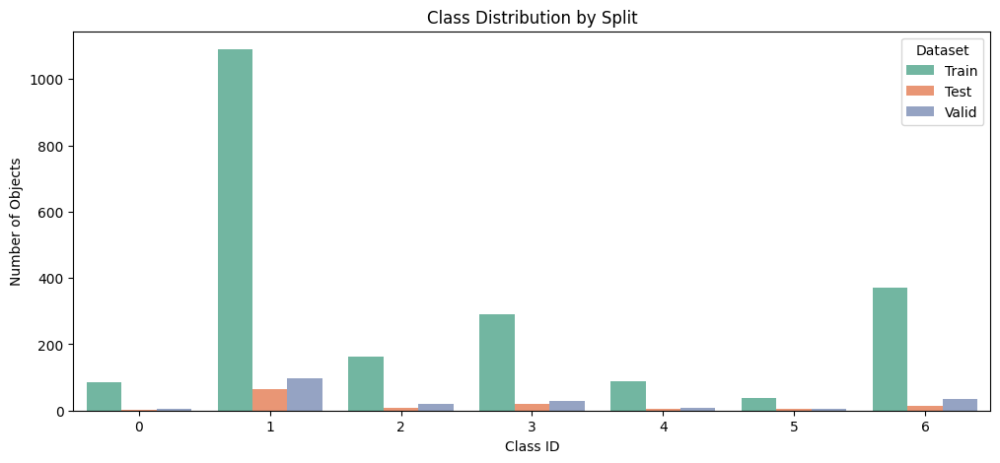

In [8]:
if all_labels_df:
    labels_df = pd.concat(all_labels_df, ignore_index=True)

    plt.figure(figsize=(12,5))
    sns.countplot(x="class_id", hue="split", data=labels_df, palette="Set2")
    plt.title("Class Distribution by Split")
    plt.xlabel("Class ID")
    plt.ylabel("Number of Objects")
    plt.legend(title="Dataset")
    plt.show()

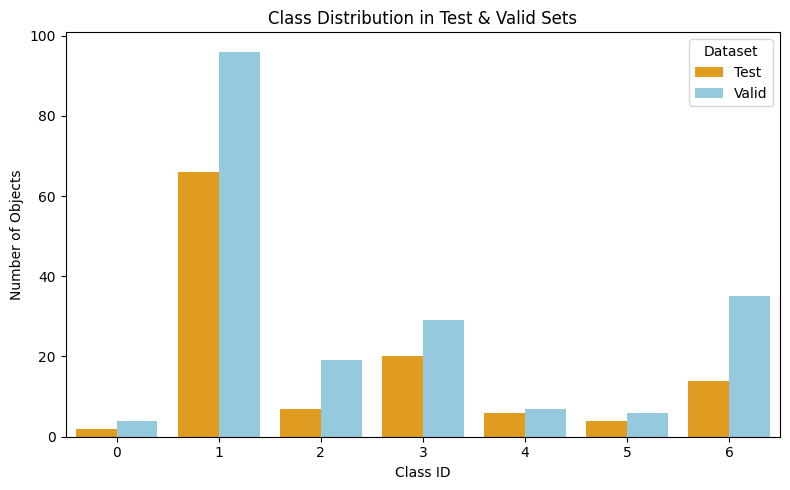

In [9]:
# Filter only Test + Valid
subset_tv = labels_df[labels_df["split"].isin(["Test", "Valid"])]

plt.figure(figsize=(8,5))
sns.countplot(
    x="class_id",
    hue="split",
    data=subset_tv,
    palette=["orange","skyblue"],
    dodge=True
)
plt.title("Class Distribution in Test & Valid Sets")
plt.xlabel("Class ID")
plt.ylabel("Number of Objects")
plt.legend(title="Dataset")
plt.tight_layout()
plt.show()


/tmp/ipykernel_36/2973414220.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()
/tmp/ipykernel_36/2973414220.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


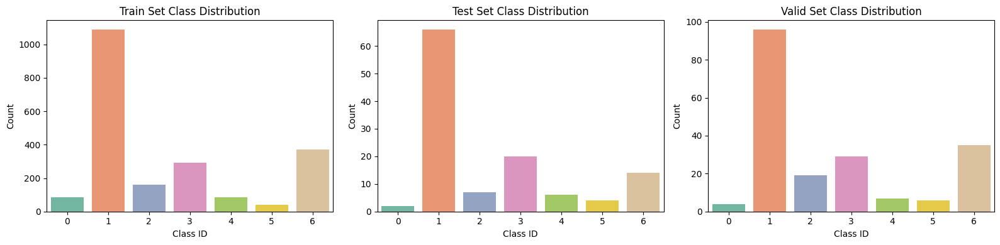

In [10]:
splits_to_plot = ["Train", "Test", "Valid"]

plt.figure(figsize=(16, 4))

for i, s in enumerate(splits_to_plot, 1):
    plt.subplot(1, 3, i)
    subset = labels_df[labels_df["split"] == s]
    sns.countplot(x="class_id", data=subset, palette="Set2")
    plt.title(f"{s} Set Class Distribution")
    plt.xlabel("Class ID")
    plt.ylabel("Count")
    plt.tight_layout()

plt.show()


**There is a clear imbalance in the classes**

# Bounding Box Size Distributions

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-l

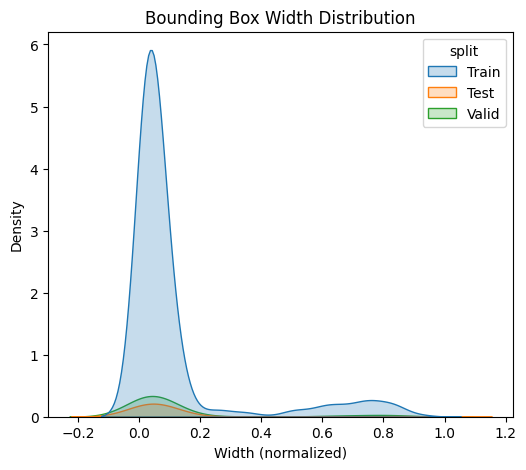

/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-l

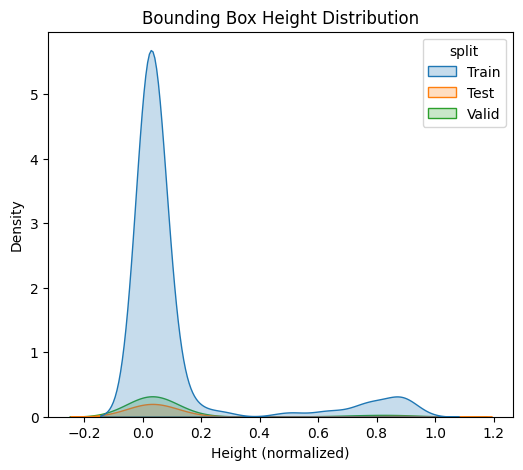

In [11]:
plt.figure(figsize=(6,5))
sns.kdeplot(data=labels_df, x="bbox_w", hue="split", fill=True)
plt.title("Bounding Box Width Distribution")
plt.xlabel("Width (normalized)")
plt.show()

plt.figure(figsize=(6,5))
sns.kdeplot(data=labels_df, x="bbox_h", hue="split", fill=True)
plt.title("Bounding Box Height Distribution")
plt.xlabel("Height (normalized)")
plt.show()

# **Model Building**

In [17]:
model = YOLO("yolo11l.pt")
model.train(
    data= "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/data.yaml",
    epochs = 200,
    imgsz= 640,
    batch = 16,
    freeze = 10,
    device = "0,1",
    optimizer = "Adam",
    amp = True,
    project="/kaggle/working/runs/detect",
    name = "train",
    augment=True,     # enable augmentation
    mosaic=True,      # combines 4 images → helps rare classes
    mixup=True,        # mixes two images → more variation
    close_mosaic = 50
)

Ultralytics 8.3.199 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=50, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/tomato-leaf-diseases-detection-computer-vision/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=True, mode=train, model=yolo11l.pt, momentum=0.937, mosaic=True, multi_scale=False, name=train2, nbs=6

/usr/local/lib/python3.11/dist-packages/ultralytics/engine/validator.py:288: RuntimeWarning: invalid value encountered in greater_equal
  matches = np.nonzero(iou >= threshold)  # IoU > threshold and classes match


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.4it/s 1.2s0.5s
                   all         61        196      0.541      0.647      0.526      0.295

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     76/200      5.58G       1.25      1.067       1.21         17        640: 100% ━━━━━━━━━━━━ 41/41 3.3it/s 12.3s0.3s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.5it/s 1.2s0.5s
                   all         61        196      0.722      0.668      0.701      0.424

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     77/200      5.65G      1.225       1.03      1.187         23        640: 100% ━━━━━━━━━━━━ 41/41 3.3it/s 12.4s0.3s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.5it/s 1.2s0.5s
                   all         61  

/usr/local/lib/python3.11/dist-packages/ultralytics/engine/validator.py:288: RuntimeWarning: invalid value encountered in greater_equal
  matches = np.nonzero(iou >= threshold)  # IoU > threshold and classes match


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.5it/s 1.2s
                   all         61        196      0.649      0.509      0.544      0.296

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     91/200      6.84G      1.219     0.9718      1.157         13        640: 100% ━━━━━━━━━━━━ 41/41 3.3it/s 12.3s0.3s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.5it/s 1.2s0.5s
                   all         61        196      0.735      0.638      0.648      0.383

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
     92/200      6.97G      1.209     0.9792      1.163         28        640: 100% ━━━━━━━━━━━━ 41/41 3.3it/s 12.3s0.3s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 3.5it/s 1.2s0.5s
                   all         61      

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         61        196      0.686      0.724      0.726      0.479
        Bacterial Spot          3          4      0.628        0.5      0.542      0.298
          Early_Blight         31         96       0.79      0.822      0.811      0.451
               Healthy         19         19          1      0.995      0.995      0.952
           Late_blight         13         29      0.802       0.84      0.927      0.734
             Leaf Mold          4          7      0.257      0.571       0.49      0.261
           Target_Spot          5          6      0.632      0.833      0.814      0.473
            black spot         21         35       0.69      0.509      0.503      0.183
Speed: 0.3ms preprocess, 48.9ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to /kaggle/working/runs/detect/train2


# **Model Validation**

In [19]:
# Load YOLO training results
df = pd.read_csv("/kaggle/working/runs/detect/train2/results.csv")

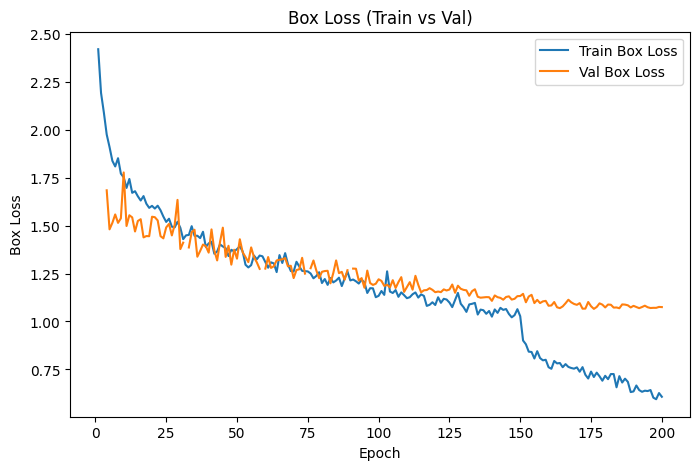

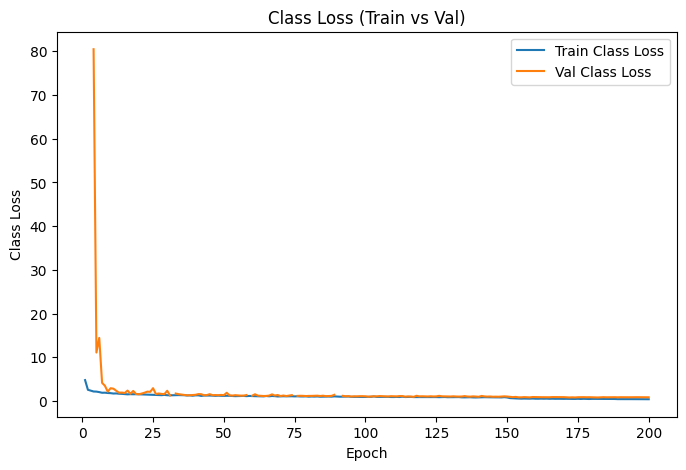

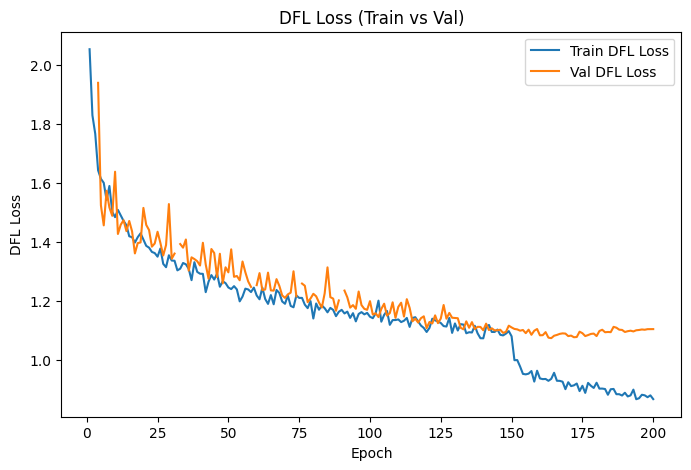

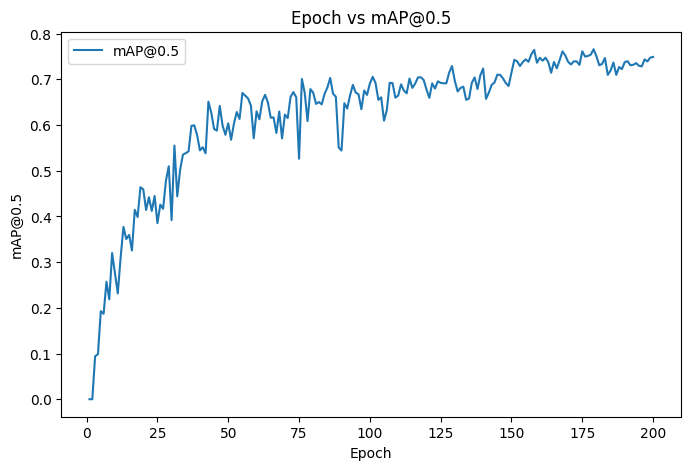

In [20]:
# --- Box Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss')
plt.xlabel('Epoch')
plt.ylabel('Box Loss')
plt.title("Box Loss (Train vs Val)")
plt.legend()
plt.show()

# --- Class Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/cls_loss'], label='Train Class Loss')
plt.plot(df['epoch'], df['val/cls_loss'], label='Val Class Loss')
plt.xlabel('Epoch')
plt.ylabel('Class Loss')
plt.title("Class Loss (Train vs Val)")
plt.legend()
plt.show()

# --- DFL Loss ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['train/dfl_loss'], label='Train DFL Loss')
plt.plot(df['epoch'], df['val/dfl_loss'], label='Val DFL Loss')
plt.xlabel('Epoch')
plt.ylabel('DFL Loss')
plt.title("DFL Loss (Train vs Val)")
plt.legend()
plt.show()

# --- mAP ---
plt.figure(figsize=(8,5))
plt.plot(df['epoch'], df['metrics/mAP50(B)'], label="mAP@0.5")
plt.xlabel('Epoch')
plt.ylabel('mAP@0.5')
plt.title("Epoch vs mAP@0.5")
plt.legend()
plt.show()


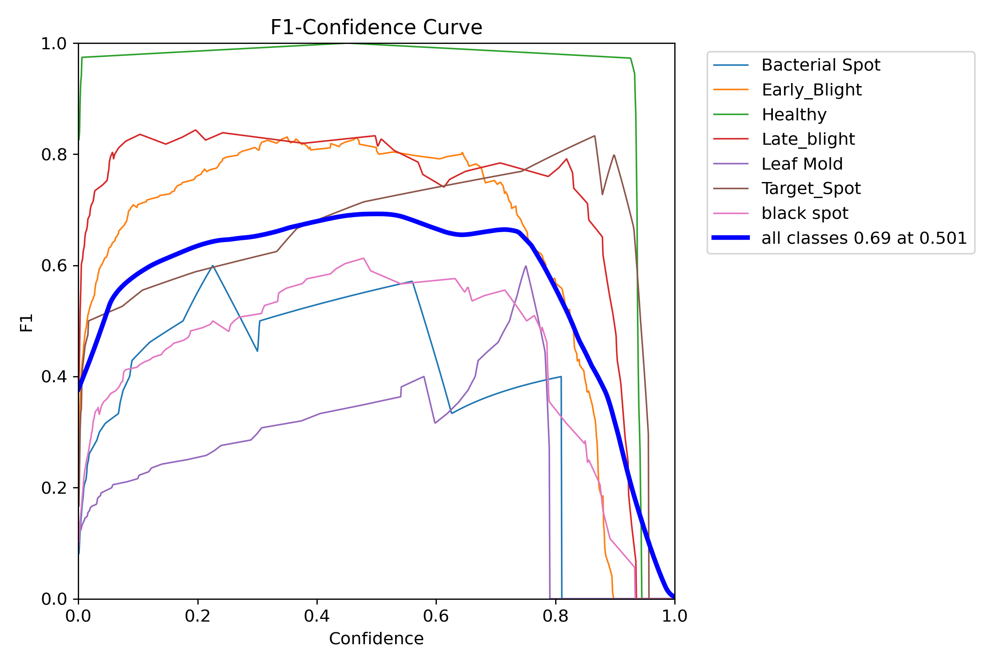

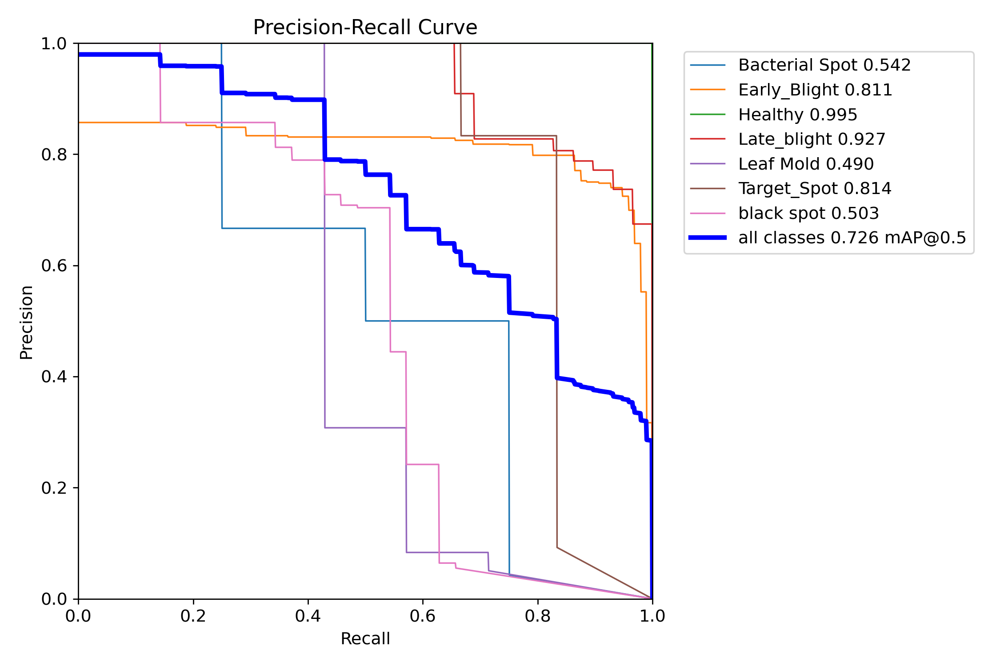

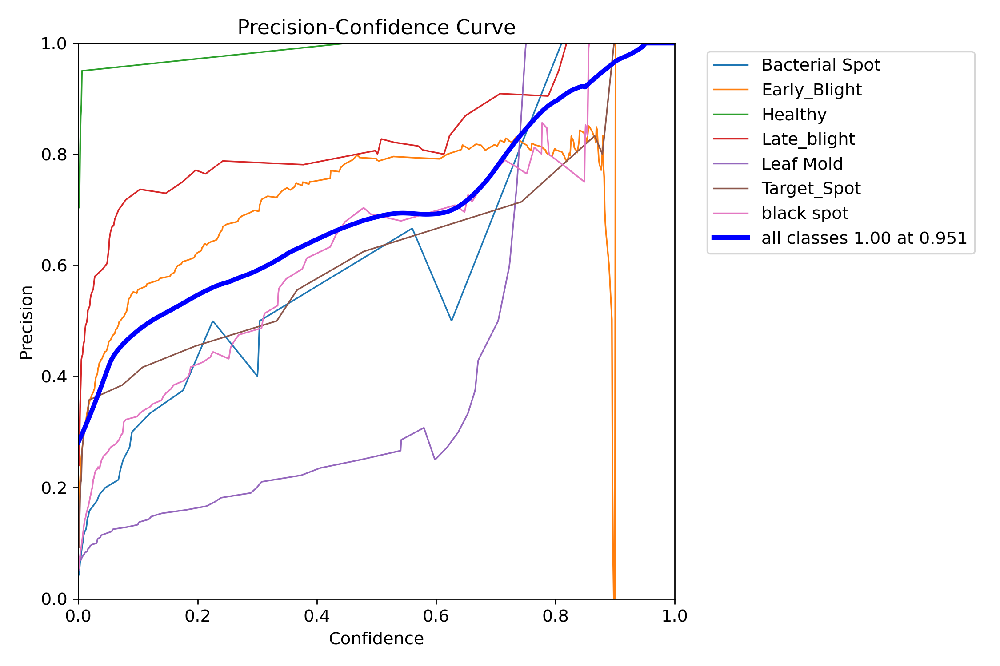

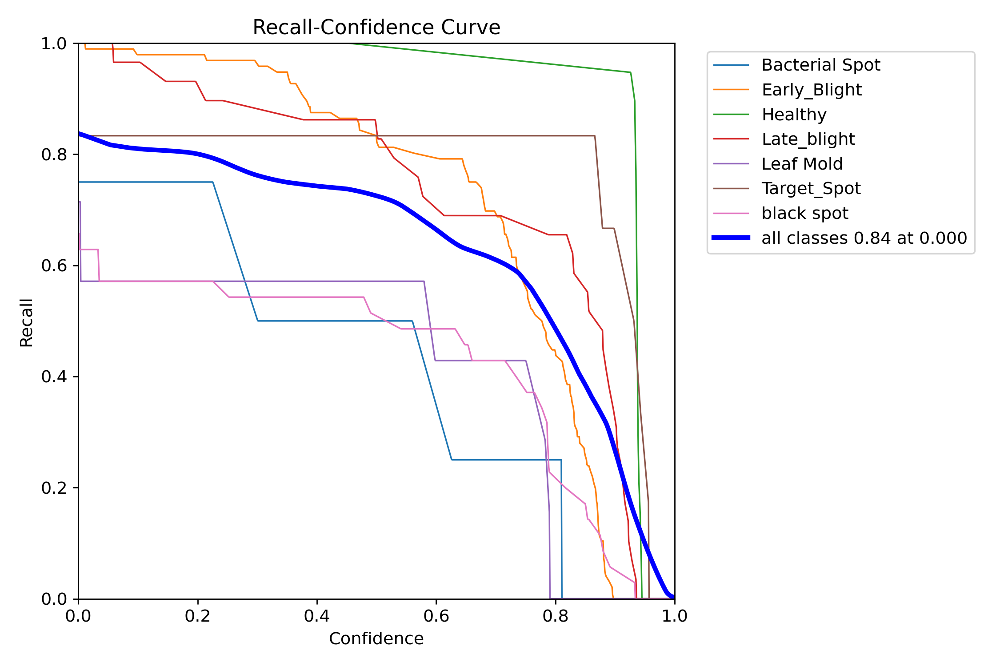

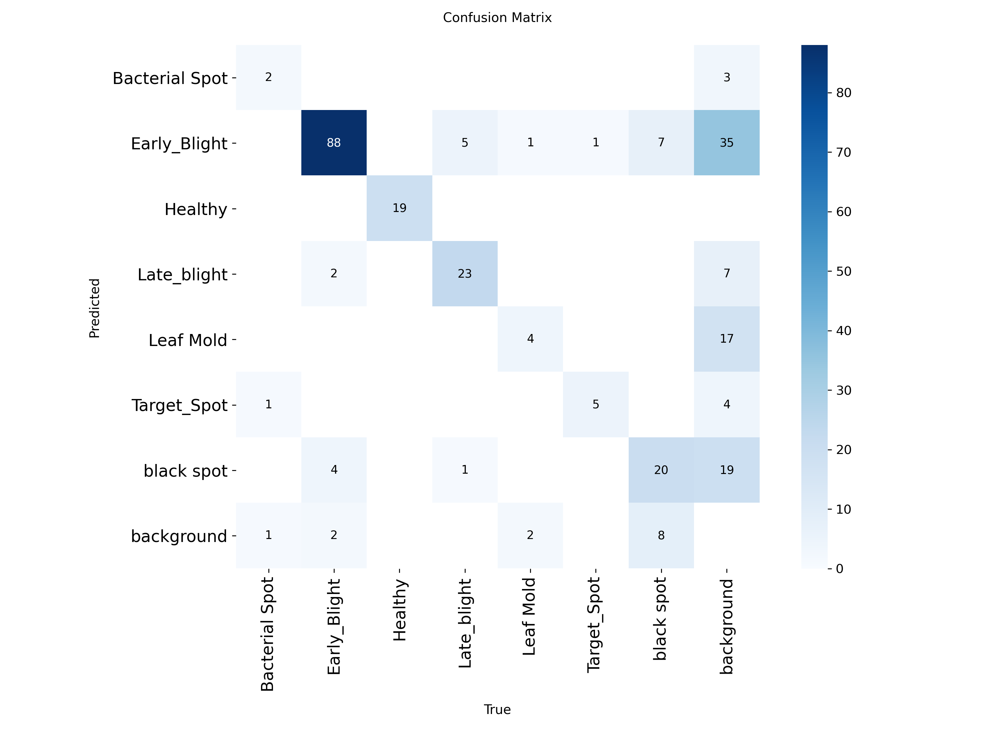

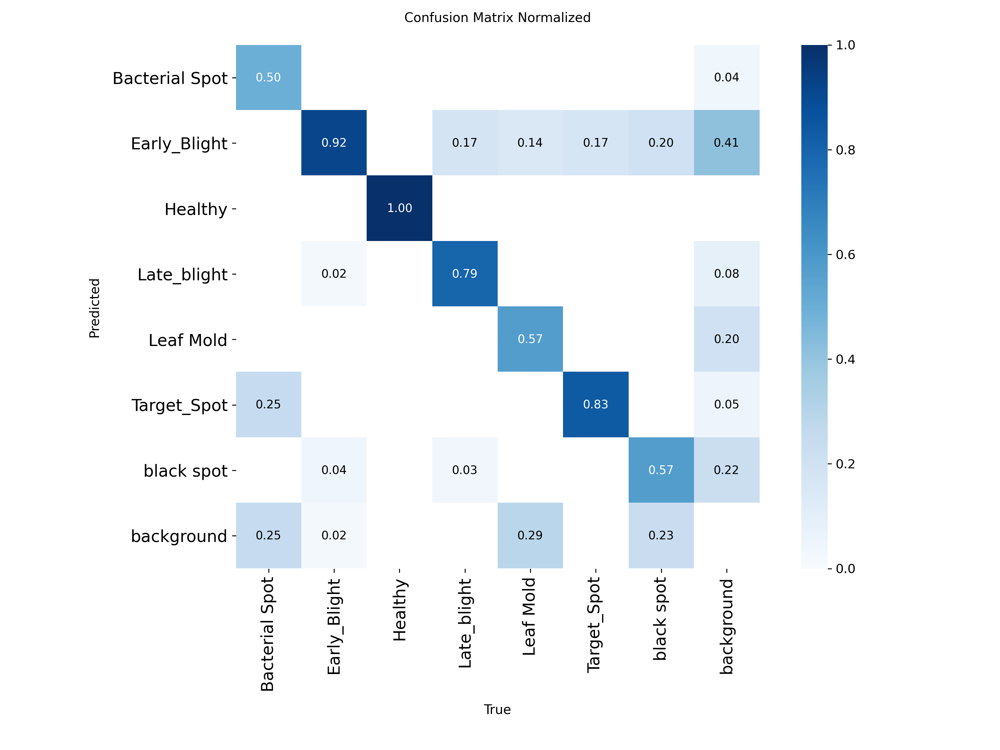

In [23]:
files = ["BoxF1_curve.png","BoxPR_curve.png","BoxP_curve.png","BoxR_curve.png","confusion_matrix.png","confusion_matrix_normalized.png"]
val_res_dir = "/kaggle/working/runs/detect/train2"
for file in files:
    img = cv2.imread(os.path.join(val_res_dir,file))
    cv2_imshow(img)
    

# **Test Evaluation**

In [32]:
model = YOLO("/kaggle/working/runs/detect/train2/weights/best.pt")

In [33]:
results_test = model.val(
    data="/kaggle/input/tomato-leaf-diseases-detection-computer-vision/data.yaml",
    split = "test"
)
results_test

Ultralytics 8.3.199 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,284,709 parameters, 0 gradients, 86.6 GFLOPs
val: Fast image access ✅ (ping: 0.7±0.2 ms, read: 60.5±9.1 MB/s, size: 30.2 KB)
val: Scanning /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/labels... 31 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 31/31 683.2it/s 0.0s
WARNING ⚠️ val: Cache directory /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test is not writeable, cache not saved.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 1.3it/s 1.6s2.9s


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         31        119      0.593      0.744      0.715      0.469
        Bacterial Spot          2          2      0.263      0.263       0.26      0.141
          Early_Blight         15         66      0.727      0.833      0.804       0.42
               Healthy          7          7      0.906          1      0.995      0.913
           Late_blight          9         20       0.77        0.8       0.85       0.59
             Leaf Mold          4          6      0.431      0.667      0.514      0.227
           Target_Spot          2          4      0.598          1      0.995      0.677
            black spot          9         14      0.456      0.643       0.59      0.311
Speed: 0.3ms preprocess, 40.5ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /kaggle/working/runs/detect/val


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d928e724250>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
  

* **Test** mAP50: 71.5%
* **Train** mAP50: 72.6%

# **Model Inference**

In [34]:
results = model.predict(
    source = "/kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images",
    save = True,
    show = False
)


image 1/31 /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images/IMG_0219_JPG.rf.c8d288f364390a28656a50ed7415713a.jpg: 640x640 1 Healthy, 47.5ms
image 2/31 /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images/IMG_0233_JPG.rf.b27c3e2dd843cab5e0f652fd1ce5659a.jpg: 640x640 1 Bacterial Spot, 4 Early_Blights, 5 Leaf Molds, 2 black spots, 43.0ms
image 3/31 /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images/IMG_0249_JPG.rf.412df0b52b549fc121a346eb8a957ab0.jpg: 640x640 2 Early_Blights, 33.4ms
image 4/31 /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images/IMG_0277_JPG.rf.84073f240decbc79e30716373f3dd507.jpg: 640x640 3 Early_Blights, 1 Leaf Mold, 2 black spots, 33.4ms
image 5/31 /kaggle/input/tomato-leaf-diseases-detection-computer-vision/test/images/IMG_0281_JPG.rf.a29c913abceeed1ea6092ab0f2c92b0d.jpg: 640x640 3 Early_Blights, 1 Leaf Mold, 2 black spots, 33.4ms
image 6/31 /kaggle/input/tomato-leaf-diseases-detect

# **Visualizing predicted bounding boxes**

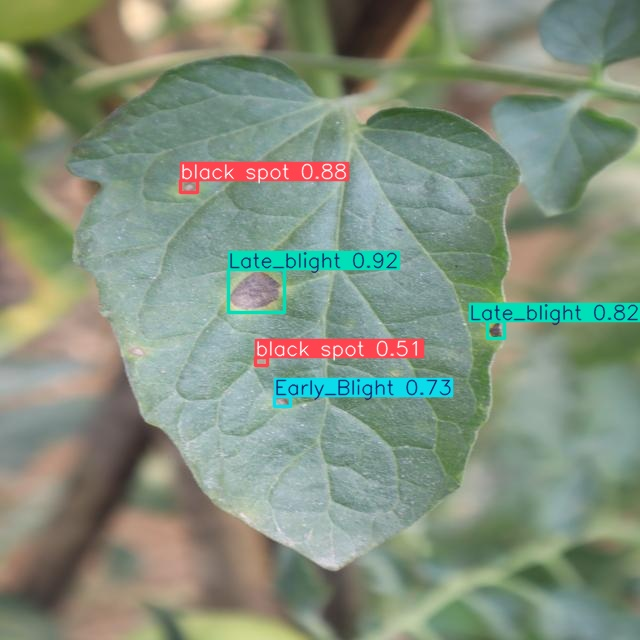

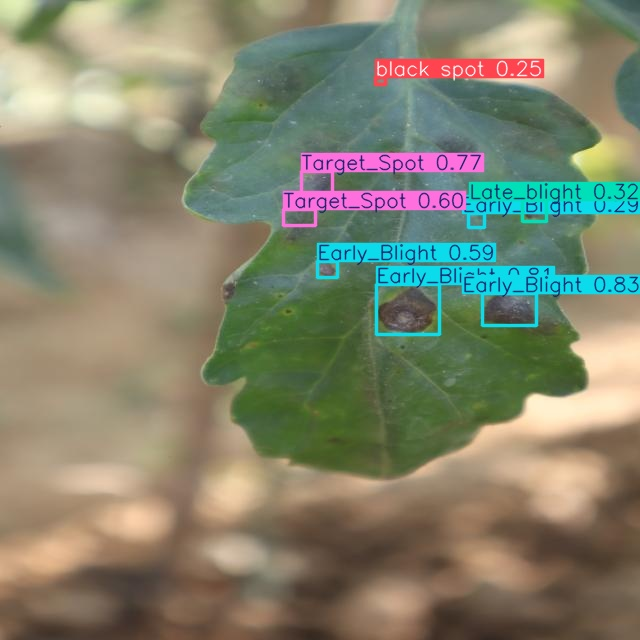

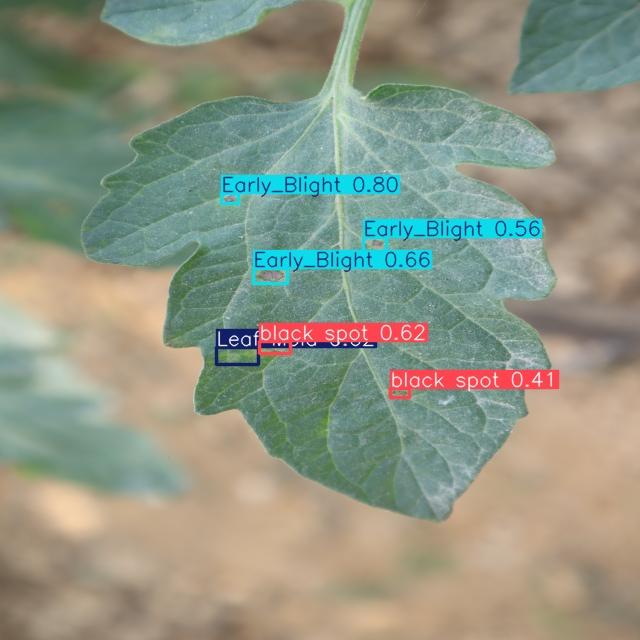

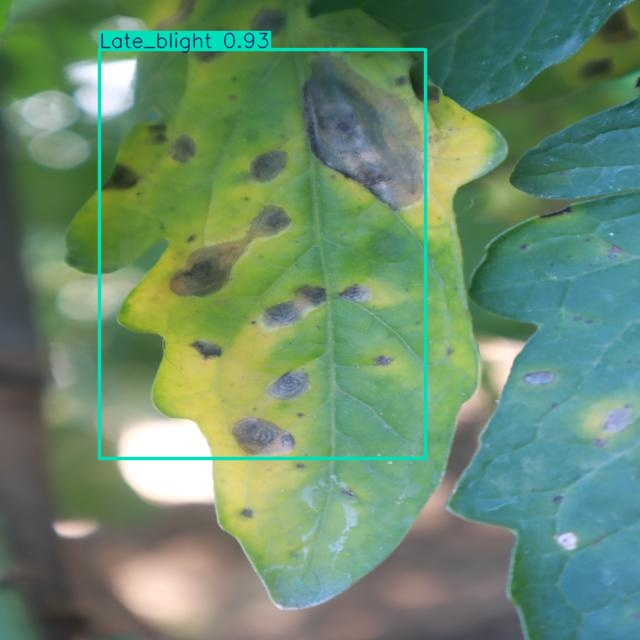

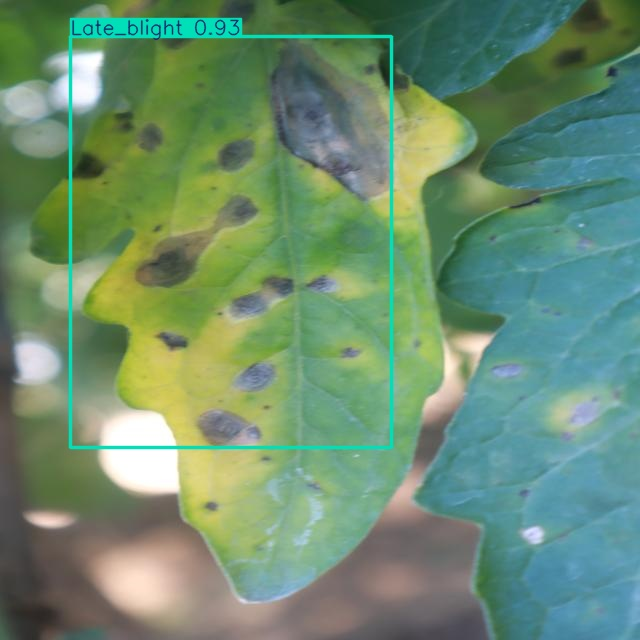

...

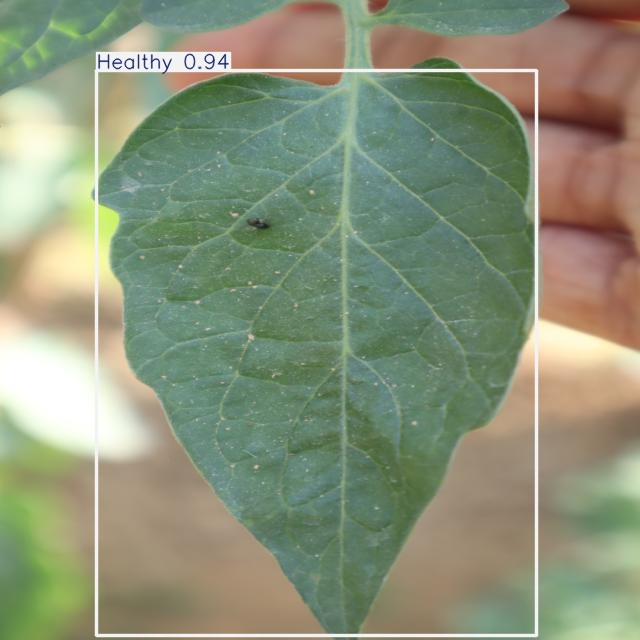

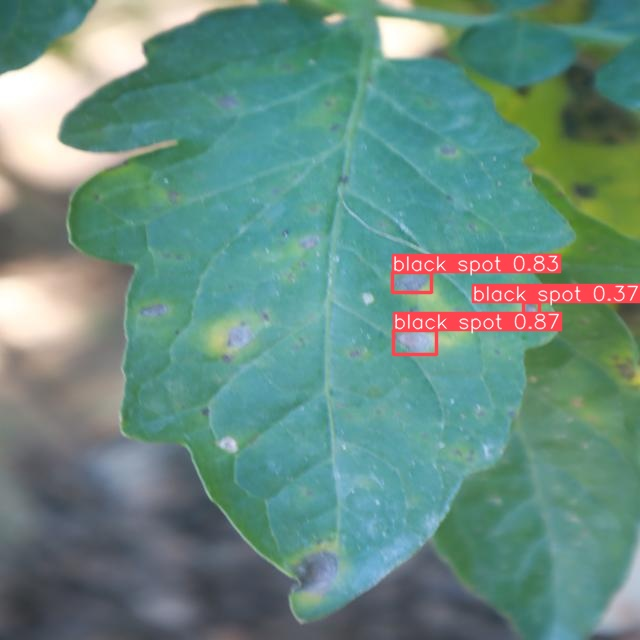

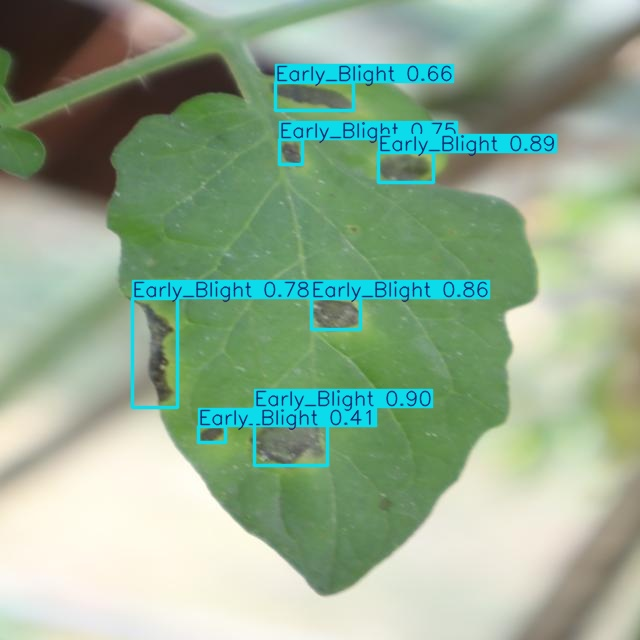

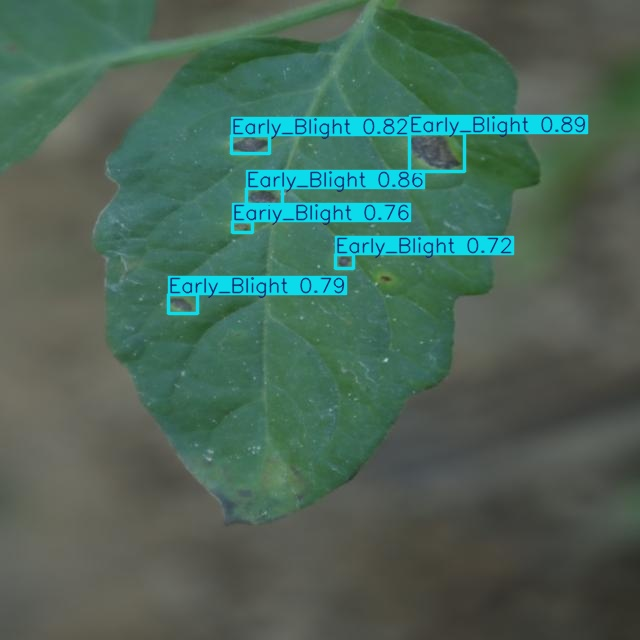

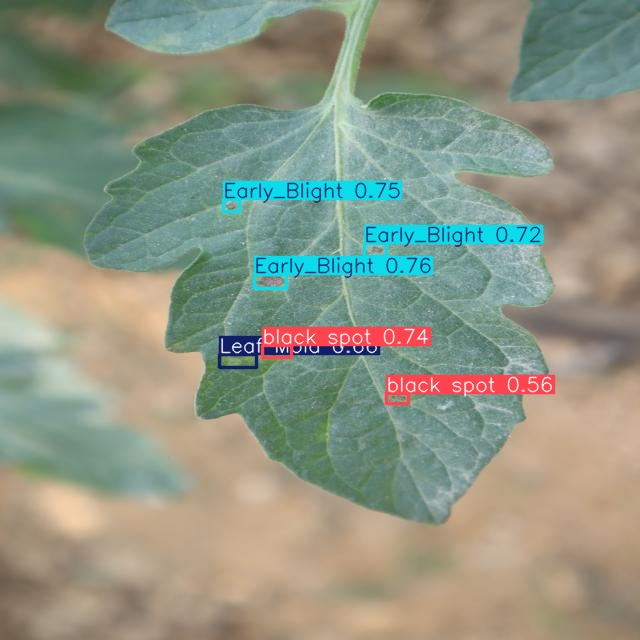

In [39]:
test_pred_dir = "/kaggle/working/runs/detect/predict"

for file in os.listdir(test_pred_dir):
    img= cv2.imread(os.path.join(test_pred_dir, file))
    cv2_imshow(img)

# **Conclusion**

* The results demonstrate that YOLO11-L provides a solid balance between accuracy and speed for automated detection of tomato leaf diseases.
* Despite natural class imbalance and without oversampling, careful use of YOLO’s augmentation pipeline enabled the model to reach >71% mAP50 on the test set, indicating good generalization to unseen images.

**This workflow highlights:**

* The importance of built-in augmentations in enhancing robustness when data is limited.
* YOLO11-L’s ability to deliver high accuracy while remaining efficient, making it practical for real-world agricultural monitoring.

Future improvements could involve experimenting with larger YOLO models (e.g., YOLO11-X), tuning augmentation strength, or collecting additional labeled images to further boost detection performance.